In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install gensim -q
!pip3 install pyLDAvis -q

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.6/2.6 MB 15.4 MB/s eta 0:00:00


In [ ]:
import csv
import re
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from ast import literal_eval
from collections import Counter

import warnings


from wordcloud import WordCloud

from sklearn.base import BaseEstimator

import gensim
from gensim import corpora, models
from gensim.models import CoherenceModel

import pyLDAvis
import pyLDAvis.gensim_models as gensimvis

import nltk
from nltk import ngrams
from nltk.corpus import stopwords

In [ ]:
warnings.filterwarnings('ignore')
pyLDAvis.enable_notebook()
random_seed = 42

Загружаем лемматизированные данные в lower case без чисел, стоп слов и знаков препинания.

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/nlp_project/data/result.csv')

In [ ]:
df.sample(10)

,result
39165,московский власть заплатить разгон облако пасх...
55863,вор унести аптека ящик виагра полицейский вычи...
29223,прежде принять человек бескорыстный помощь сле...
110995,жена уходить магазин предупредить муж быть вар...
72208,год муж жена становиться очень похожий друг др...
4430,понять черчёс отстранить дзюба сборная просто ...
69875,неудобно трусик булка застревать нафиг трус хл...
92027,россия ввести такой наказание воровство саудов...
24355,весь семья отдохнуть один путёвка нужно отправ...
79290,еврейский шахматист сделать потрясать открытие...


##Попробуем сделать кластеризацию по темам с помощью LDA(Latent Dirichlet Allocation).

###Основные метрики для сравнения LDA-моделей - *Coherence_Score u_mass* и *Perplexity*

UMass метрика основывается на совместной встречаемости слов в документе и вычисляется следующим образом:

1. **Совместная встречаемость**: Определяются пары слов, которые встречаются вместе в документе.
2. **Условная вероятность**: Рассчитывается вероятность появления одного слова при условии наличия другого слова в документе.
3. **Логарифмическая функция**: Применяется логарифм к условной вероятности.

Формула для расчета UMass:

$$
\text{Coherence}(U\text{-mass}) = \sum_{m=2}^{M} \sum_{l=1}^{m-1} \log \frac{D(w_m, w_l) + \epsilon}{D(w_l)}
$$

Где:
- $D(w_m, w_l)$  — количество документов, в которых встречаются оба слова $w_m$ и $w_l$.
- $D(w_l)$ — количество документов, в которых встречается слово $w_l$.
- $ \epsilon$ — малое значение для предотвращения деления на ноль.

Perplexity же измеряет насколько хорошо модель предсказывает слово в документах и, соответственно, насколько хорошо модель "понимает" структуру данных.

Перплексия можно понимать как среднюю вероятностную неопределенность при предсказании слова в тексте. Математически она определяется как экспонента усреднённого значения логарифма вероятности тестового набора, сгенерированного моделью.

Формула для расчета Perplexity:

$$
\text{per}(D_{\text{test}}) = \exp \left\{ - \frac{\sum_{d=1}^{M} \log P(w_d)}{\sum_{d=1}^{M} N_d} \right\}
$$

Где:
- $M$ — общее количество слов в тестовом наборе документов.
- $N_d$ - количество слов в документе d
- $P(w_{d})$ — вероятность последовательности слов в документе.

In [ ]:
def get_Coherence_Score_u_mass(lda_model, documnets, corpus):
  """
  Compute Coherence_Score. Чем выше, тем лучше
  """
  coherence_model_lda = CoherenceModel(model=lda_model, texts=documents, corpus=corpus, coherence='u_mass')
  coherence_lda = coherence_model_lda.get_coherence()
  return coherence_lda

In [ ]:
def get_Perplexity_Score(lda_model, corpus):
  """
  Compute Perplexity. Чем ниже, тем лучше
  """
  return lda_model.log_perplexity(corpus)

In [ ]:
def show_results(lda_model, corpus, dictionary):
  """
  Визуализируем тематические классы в виде кругов и выводим топ важных для темы слов
  """
  vis_base = gensimvis.prepare(lda_model, corpus, dictionary)
  return vis_base

In [ ]:
def show_formula_topics(lda_model):
  """
  Выводим содержимое топика в виде формулы p*word, где p-значимость слова word
  """
  formulas = lda_model.print_topics()
  return formulas

In [ ]:
def make_bigrams(texts):
  return [bigram_mod[doc] for doc in texts]

In [ ]:
def plotWordCloud_Gensim(topic_number,topics):
    text = dict(topics[topic_number][1])
    wordcloud = WordCloud(background_color="white", max_words=100, width=700, height=700, collocations=False)
    wordcloud = wordcloud.generate_from_frequencies(text)
    plt.figure(figsize=(8, 8))
    plt.title(f"Тема номер {topic_number}")
    #plt.savefig(f'/content/drive/MyDrive/nlp_project/data/pic_{topic_number}')
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")

In [ ]:
def generate_clouds(num_topics, topics):
  for i in range(num_topics):
    plotWordCloud_Gensim(i, topics)

In [ ]:
def make_training_data(documents, need_bigrams:bool, no_below):
  """
  Создаем данные, необходимые для обучения gensim LDA из данного набора предобработанных текстов.
  Если need_bigrams = True, то в итоговый корпус добавляем также биграммы
  В corpus - итоговые данные для обучения.
  no_below - отбрасываем слова, встречающиеся меньше чем в no_below анекдотах

  """
  # documents = df["result"].values
  tokenized_documents = [doc.split() for doc in documents]

  if need_bigrams:
    bigram = models.Phrases(tokenized_documents, min_count = 3, threshold = 4)
    bigram_mod = models.phrases.Phraser(bigram)
    result_texts = make_bigrams(tokenized_documents)
  else:
    result_texts = tokenized_documents

  dictionary = gensim.corpora.Dictionary(result_texts)
  print('Размер словаря до фильтрации: {}'.format(len(dictionary)))

  dictionary.filter_extremes(no_below = no_below, no_above=0.3)
  dictionary.compactify()
  print('Размер словаря после фильтрации: {}'.format(len(dictionary)))

  dictionary_witout_bigrams = gensim.corpora.Dictionary(tokenized_documents)
  dictionary_witout_bigrams.filter_extremes(no_below=no_below, no_above=0.3)
  dictionary_witout_bigrams.compactify()
  print('Размер словаря без биграм после фильтрации: {}'.format(len(dictionary_witout_bigrams)))

  # Векторизуем данные и сохраняем в бинарном формате

  corpus = [dictionary.doc2bow(text) for text in result_texts]
  path_to_save = f'/content/drive/MyDrive/nlp_project/lda_models/corpus_bigrams={need_bigrams}'
  with open(path_to_save, 'wb') as f:
    pickle.dump(corpus, f)

  return tokenized_documents, result_texts, corpus, dictionary

In [ ]:
def train_LDA(corpus, dictionary, num_topics, need_bigrams):
  """
  Обучение LDA модели с заданным словарем, корпусом и количеством топиков.
  passes = 10 подобран, как дефолтный параметр.
  Сохраняем получившиеся топики и саму модель в бинарном формате.
  """
  lda_model = models.ldamodel.LdaModel(
    corpus = corpus,
    id2word = dictionary,
    num_topics = num_topics,
    passes = 7,
    random_state = random_seed
)
  path_to_save = f'/content/drive/MyDrive/nlp_project/lda_models_{num_topics}_bigrams={need_bigrams}'
  lda_model.save(path_to_save)

  topics = lda_model.show_topics(
      num_topics = num_topics,
      num_words = 100,
      formatted = False
  )
  path_to_save_topics = path_to_save + '_topics'
  with open(path_to_save_topics, 'wb') as f:
    pickle.dump(topics, f)
  return lda_model, topics


Обучим модель пока что без настройки гиперпараметров. num_topics = 20 интуитивно. Также добавим биграмы к словарю и сохраним для каждого из топиков топ100 наиболее вероятных для него слов и визуализируем с помощью облаков слов.

In [ ]:
tokenized_documents, result_texts, corpus, dictionary = make_training_data(df['result'].values, True, 7)

Размер словаря до фильтрации: 79541
Размер словаря после фильтрации: 19714
Размер словаря без биграм после фильтрации: 14579


In [ ]:
lda_20_bigrams, topics_20_bigrams = train_LDA(corpus, dictionary, 20, True)

Теперь визуализируем результат и подсчитаем метрики.

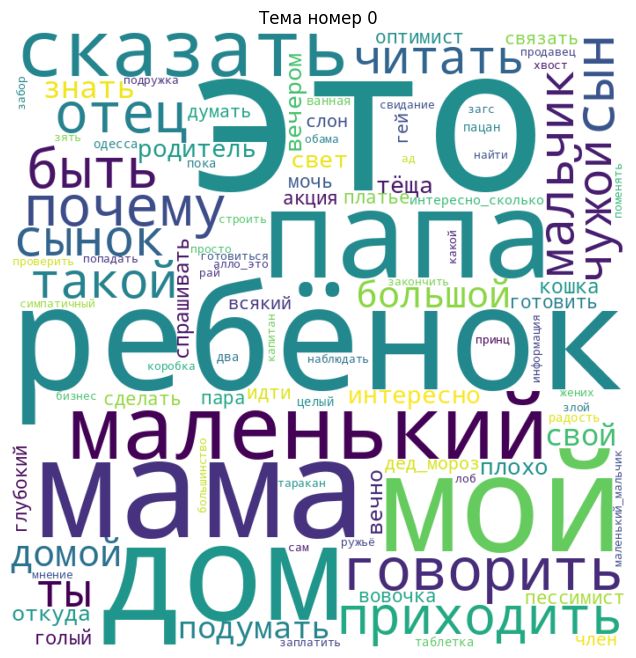

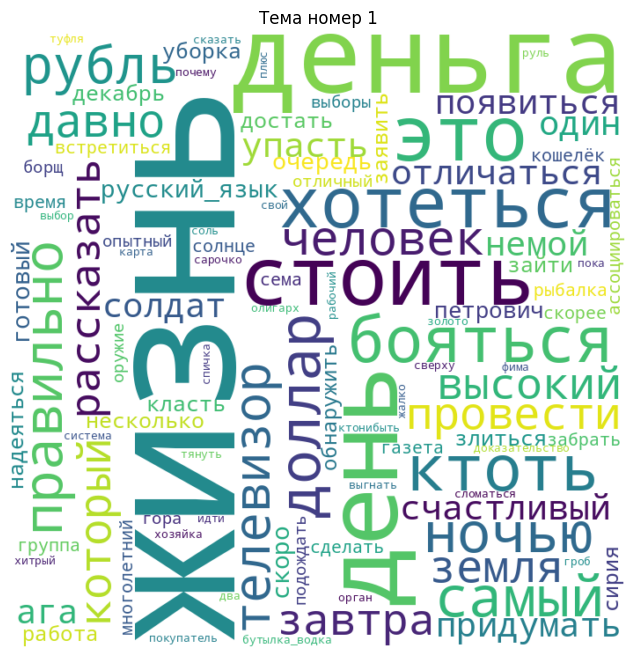

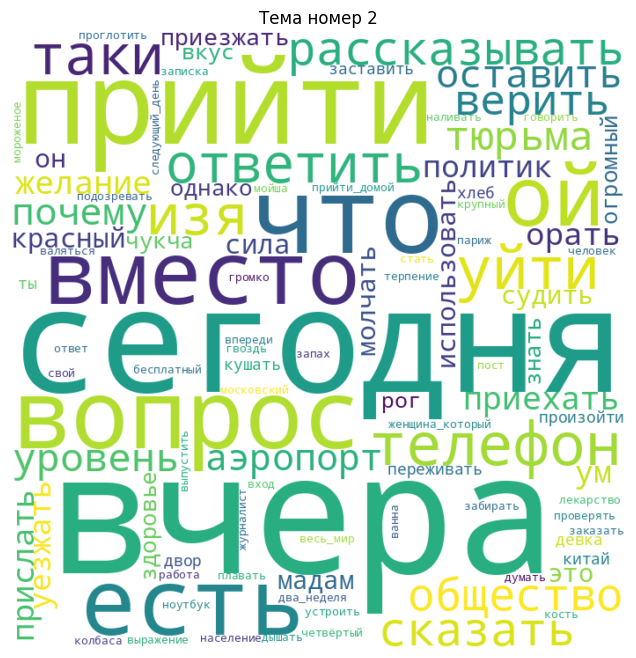

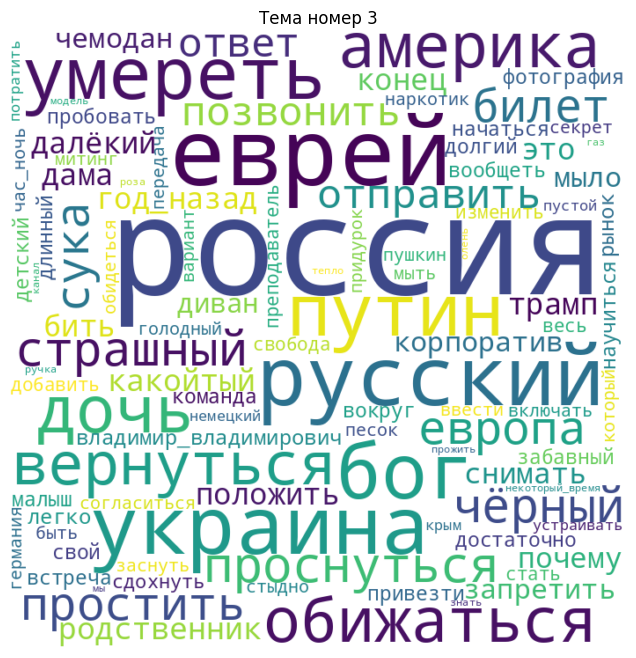

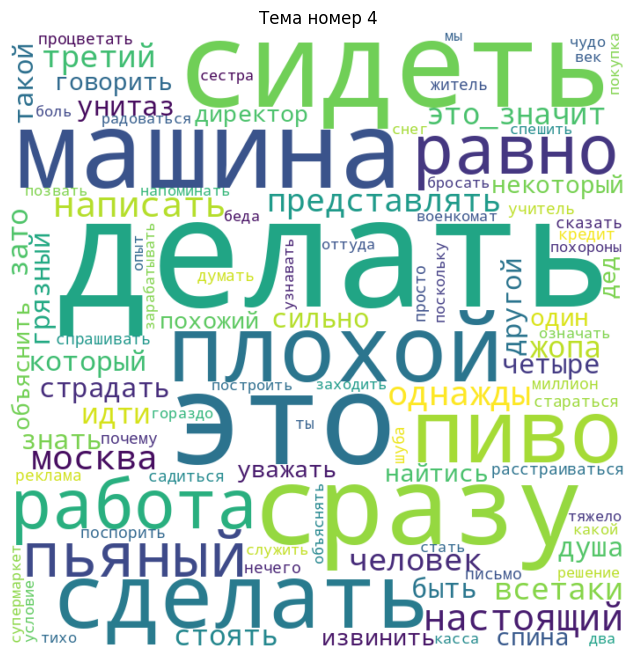

...

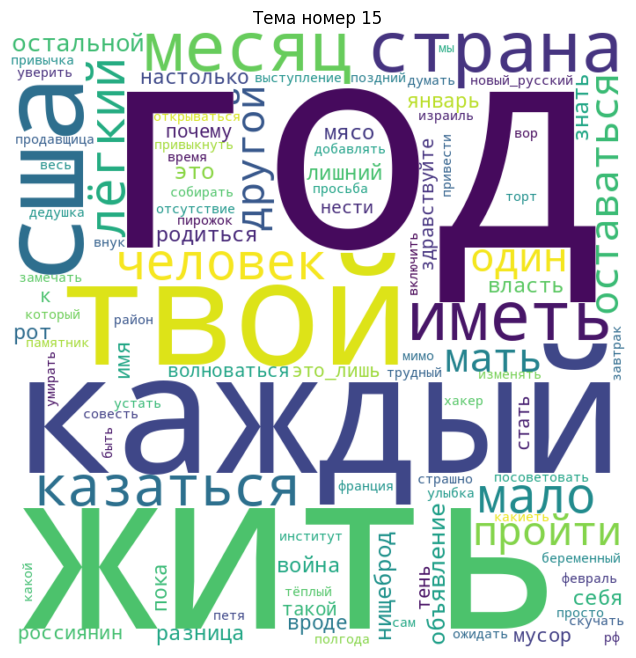

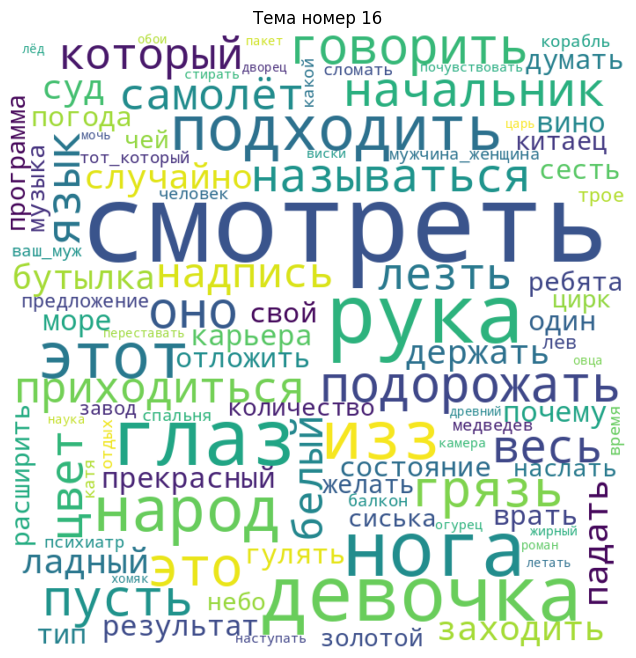

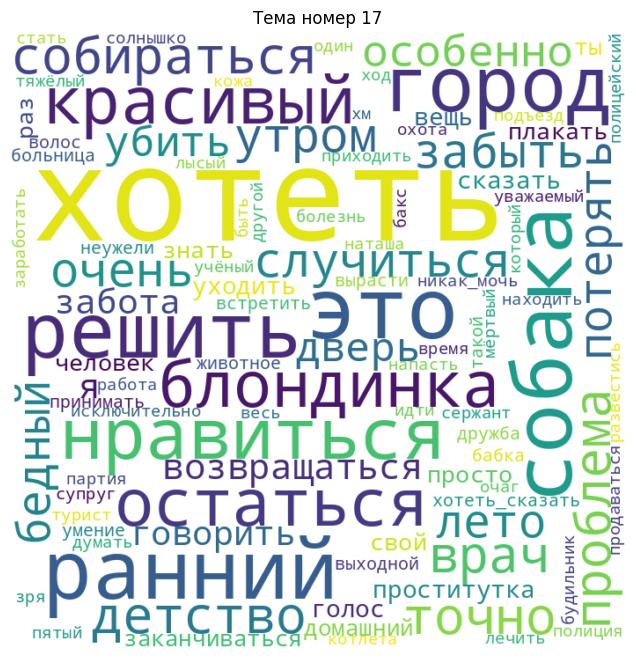

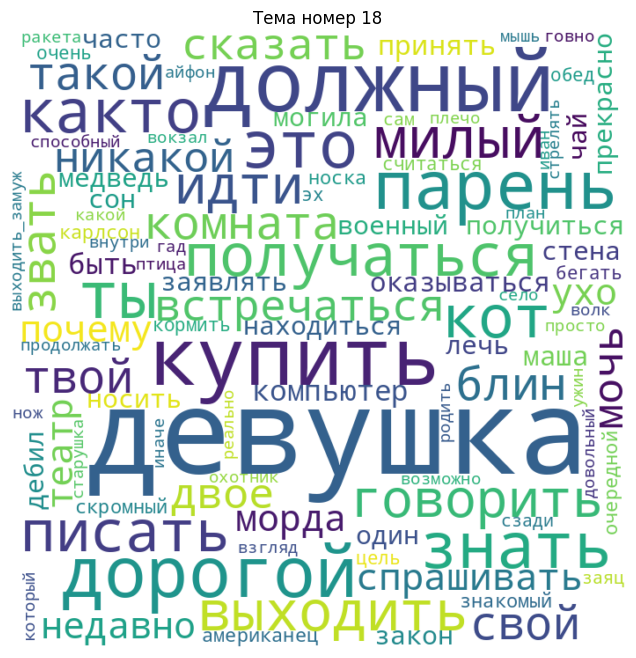

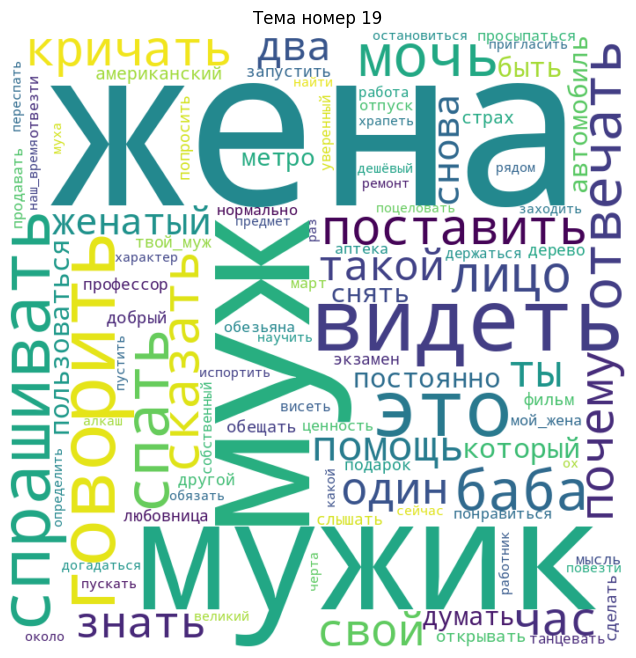

In [ ]:
generate_clouds(20, topics_20_bigrams)

In [ ]:
show_results(lda_20_bigrams, corpus, dictionary)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0      0.181784  0.007180       1        1  6.524104
19     0.185468  0.006685       2        1  6.413352
18     0.153094  0.012942       3        1  5.818579
17     0.052148 -0.023582       4        1  5.282348
4      0.096400 -0.056304       5        1  5.241937
6      0.068190  0.040678       6        1  5.229683
14    -0.050836 -0.160318       7        1  5.018573
12     0.108356  0.064684       8        1  4.937371
1     -0.087196 -0.120690       9        1  4.905374
15    -0.097374 -0.047377      10        1  4.874362
5      0.030948 -0.081678      11        1  4.822153
13     0.060808  0.087765      12        1  4.704070
10     0.049505  0.062281      13        1  4.701226
8      0.006216 -0.124899      14        1  4.684404
7     -0.106352 -0.184761      15        1  4.641641
9     -0.237497  0.101865      16        1  4.633629
16    -0.061546  0.023346      17        1  4.540681
3     -0.125881  0.249035      18        1  4.507468
2     -0.027538  0.173625      19        1  4.424125
11    -0.198697 -0.030476      20        1  4.094921, topic_info=         Term         Freq        Total Category  logprob  loglift
13       жена  7692.000000  7692.000000  Default  30.0000  30.0000
31    женщина  7061.000000  7061.000000  Default  29.0000  29.0000
54    мужчина  4916.000000  4916.000000  Default  28.0000  28.0000
268   девушка  4996.000000  4996.000000  Default  27.0000  27.0000
573    хотеть  4719.000000  4719.000000  Default  26.0000  26.0000
...       ...          ...          ...      ...      ...      ...
2890     туда   354.482302   355.710687  Topic20  -4.7730   3.1920
66    человек  1414.477103  7248.467979  Topic20  -3.3891   1.5614
206    почему   749.517802  6525.286705  Topic20  -4.0242   1.0314
341      весь   471.887366  2007.309513  Topic20  -4.4869   1.7476
134      свой   539.422863  6063.190668  Topic20  -4.3531   0.7759

[748 rows x 6 columns], token_table=      Topic      Freq        Term
term                             
1195     11  0.998356       абрам
1108     16  0.997488     автобус
3267      2  0.997154  автомобиль
2225      9  0.997763         ага
3189      1  0.995213       акция
...     ...       ...         ...
589      13  0.996857    являться
820      17  0.997139        язык
1212     15  0.996595        яйцо
1722     10  0.996963      январь
3515     14  0.998243        ёлка

[962 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 20, 19, 18, 5, 7, 15, 13, 2, 16, 6, 14, 11, 9, 8, 10, 17, 4, 3, 12])

In [ ]:
show_formula_topics(lda_20_bigrams)

[(0,
  '0.055*"это" + 0.046*"ребёнок" + 0.041*"мама" + 0.039*"мой" + 0.038*"дом" + 0.031*"папа" + 0.025*"маленький" + 0.022*"сказать" + 0.019*"говорить" + 0.018*"сын"'),
 (1,
  '0.073*"жизнь" + 0.063*"деньга" + 0.053*"день" + 0.034*"стоить" + 0.030*"это" + 0.025*"хотеться" + 0.021*"ктоть" + 0.021*"бояться" + 0.017*"доллар" + 0.016*"ночью"'),
 (2,
  '0.060*"вчера" + 0.054*"сегодня" + 0.032*"прийти" + 0.027*"что" + 0.026*"вопрос" + 0.024*"есть" + 0.021*"вместо" + 0.019*"ой" + 0.018*"телефон" + 0.018*"уйти"'),
 (3,
  '0.079*"россия" + 0.029*"еврей" + 0.023*"русский" + 0.022*"украина" + 0.019*"бог" + 0.017*"путин" + 0.017*"умереть" + 0.014*"дочь" + 0.013*"америка" + 0.012*"обижаться"'),
 (4,
  '0.065*"делать" + 0.044*"это" + 0.039*"сидеть" + 0.032*"сразу" + 0.031*"машина" + 0.022*"плохой" + 0.020*"сделать" + 0.020*"пиво" + 0.015*"работа" + 0.015*"равно"'),
 (5,
  '0.040*"кто" + 0.038*"это" + 0.021*"поэтому" + 0.020*"узнать" + 0.019*"считать" + 0.019*"фраза" + 0.018*"нужный" + 0.017*"получи

In [ ]:
Coherence_Score = get_Coherence_Score_u_mass(lda_20_bigrams, df['result'].values, corpus)
Perplexity_Score = get_Perplexity_Score(lda_20_bigrams, corpus)
print("Coherence_Score: ", Coherence_Score, "Perplexity_Score: ", Perplexity_Score)

Coherence_Score:  -6.934257161507029 Perplexity_Score:  -14.359920602196011


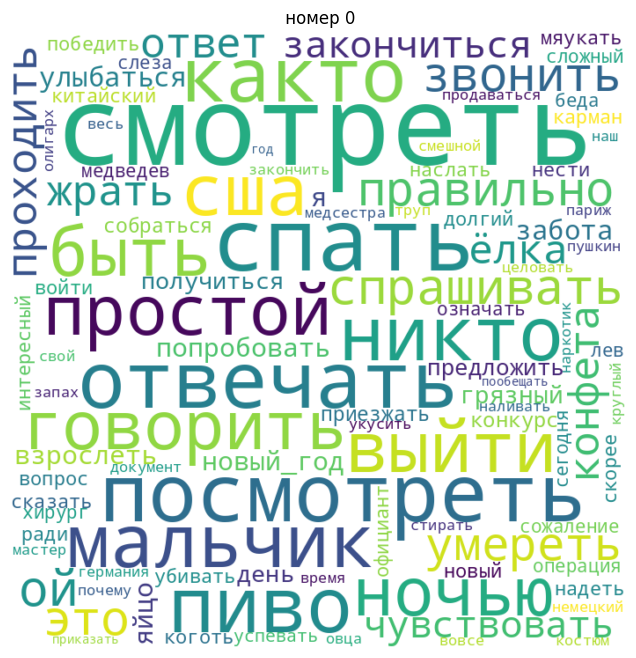

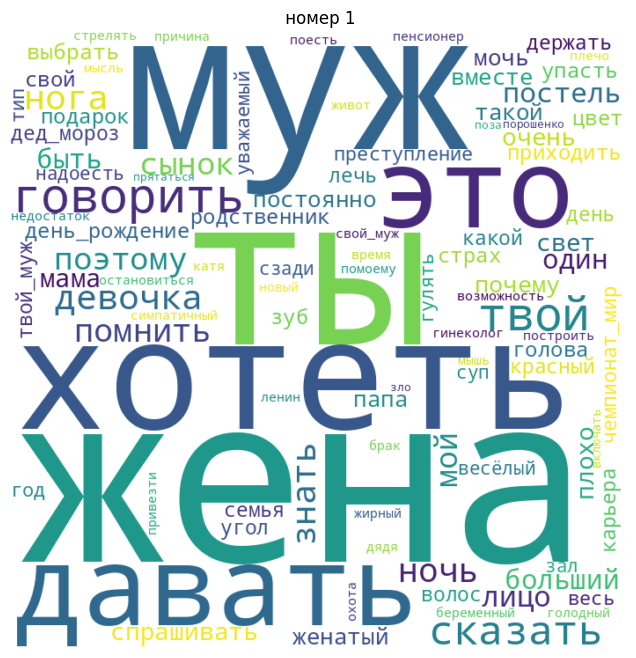

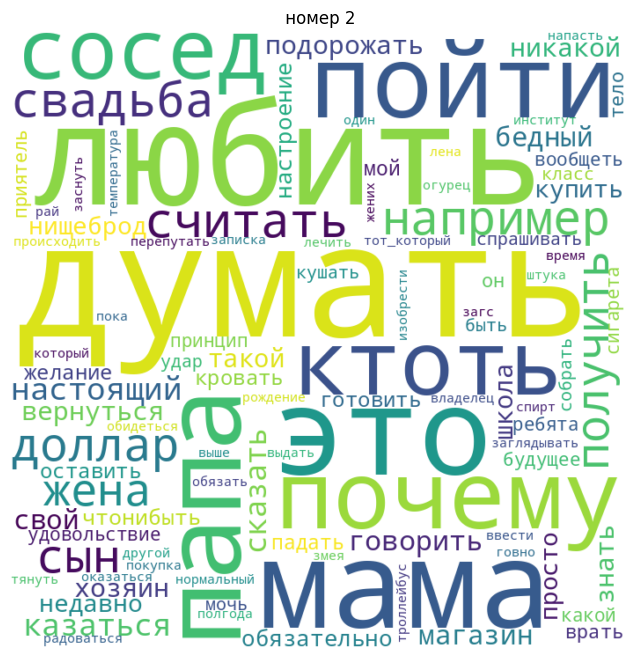

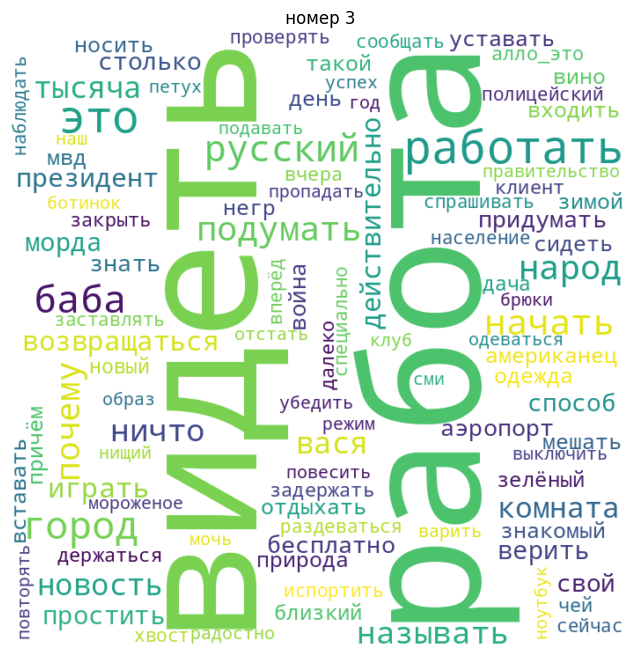

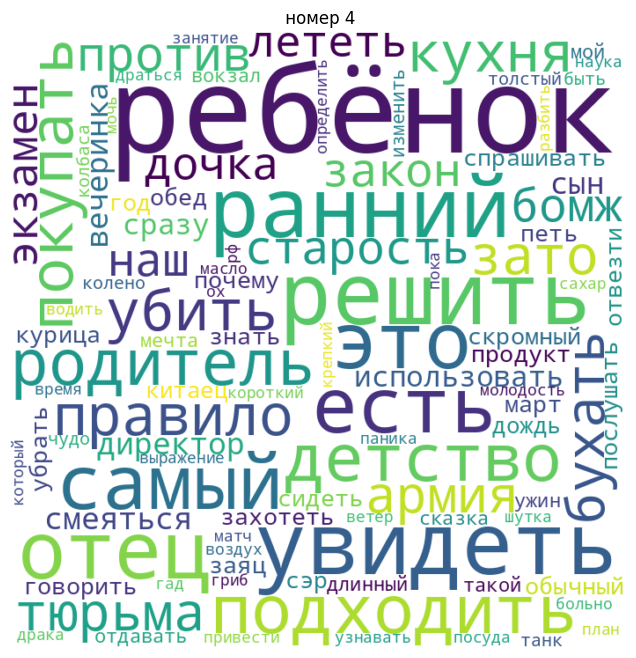

...

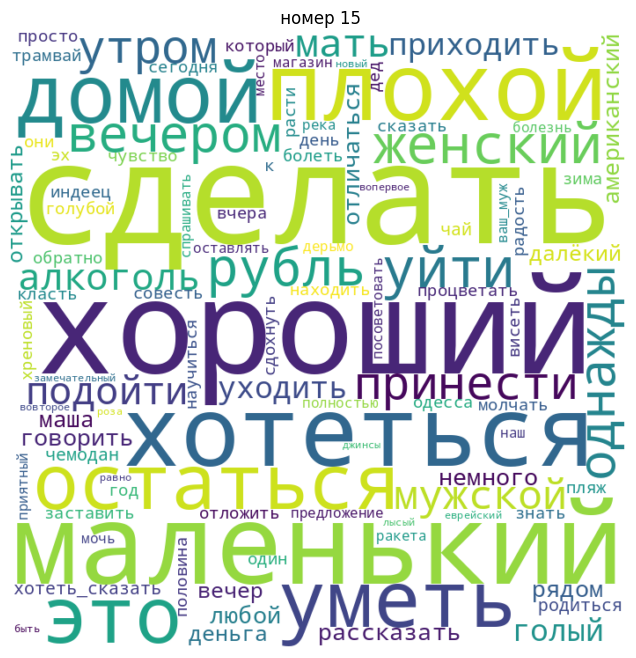

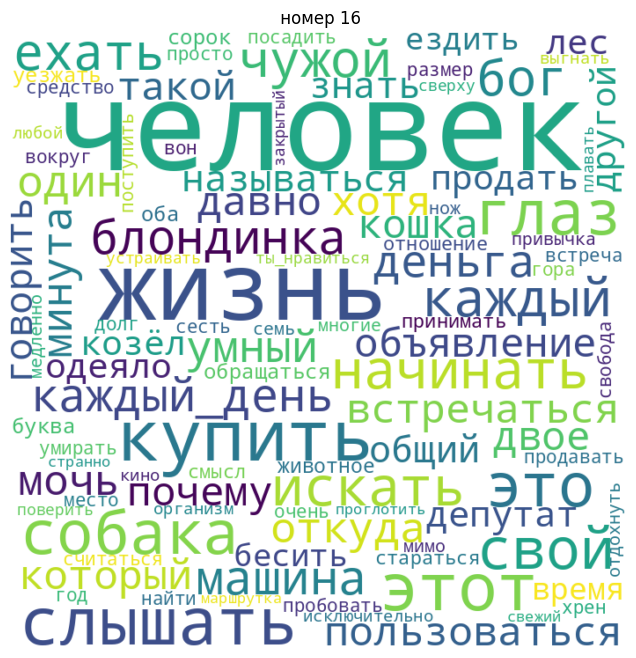

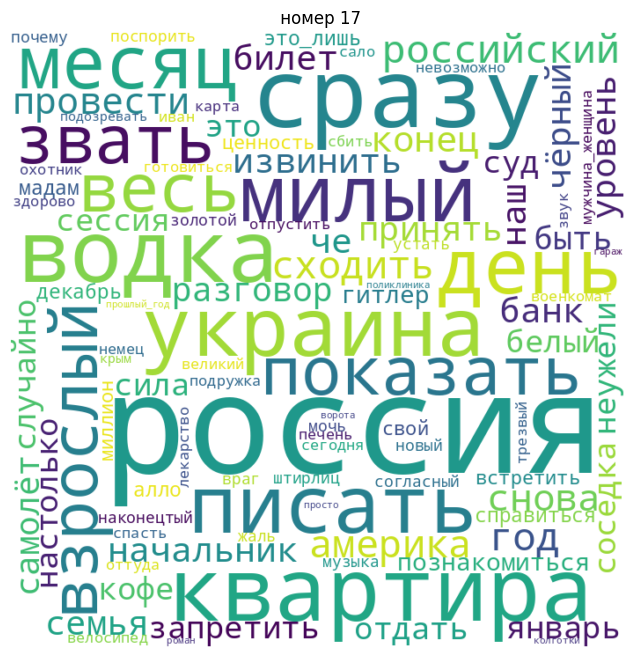

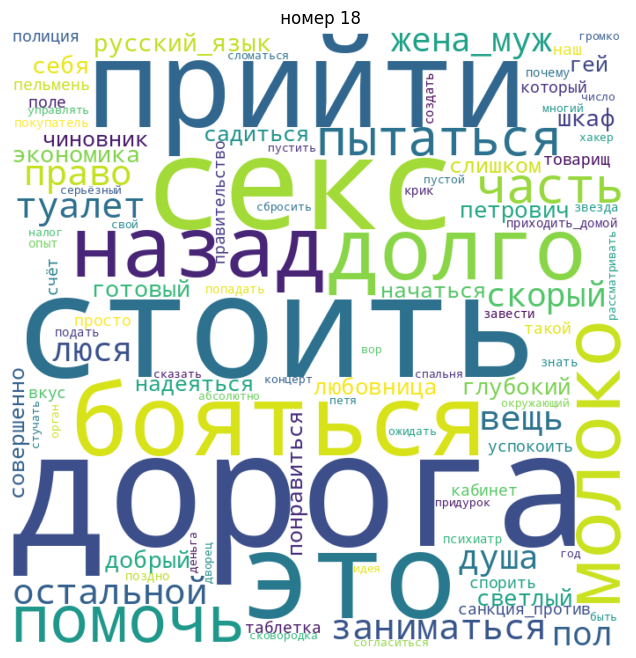

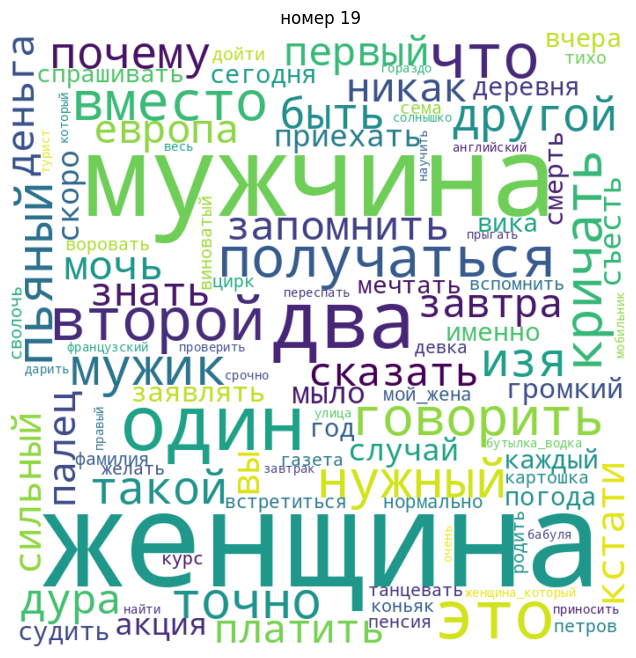

In [ ]:
for i in range (0,20): #это самые первые топики, пусть пока что будут тут
  plotWordCloud_Gensim(i, topics)

Оценивая облака слов, видно, что разбиению по темам мешают самые частовстречающиеся слова, не несущие никакой эмоциональной окраски(например, нужно, кто, стать, идти, это и тд). Видимо, эти слова встречаютя реже чем в 20% текстов. Уберем их из датасета

In [ ]:
words = [word for line in df["result"] for word in line.split()]
word_counts = Counter(words)
most_common_words = word_counts.most_common(20)
least_common_words = word_counts.most_common()[-20:-1]
df_common = pd.DataFrame(most_common_words, columns=['word', 'frequency'])
df_least_common = pd.DataFrame(least_common_words, columns = ['word', 'frequency'])
df_common

,word,frequency
0,это,17667
1,человек,7487
2,говорить,7162
3,жена,6747
4,свой,6117
5,женщина,5755
6,который,5655
7,знать,5457
8,почему,5428
9,год,5162


In [ ]:
df_least_common

,word,frequency
0,вещьпрезерватив,1
1,вывозной,1
2,маслов,1
3,лакив,1
4,зацеперов,1
5,трейсеров,1
6,руфер,1
7,селфер,1
8,отцовоснователь,1
9,североамериканский,1


Интуитивно: удалять слова женщина, мужчина, девушка и прочее не надо, так как, скорее всего, это просто самый большой тематический кластер.

In [ ]:
common = ['это', 'человек', 'говорить', 'свой', 'знать', 'который', 'знать', 'почему','год', 'хотеть', 'сказать', 'такой', 'один', 'ты', 'мочь', 'день']

In [ ]:
def remove_common_from_text(text: str) -> str:
    """
    Функция для удаления частыx слов из текста
    """
    words = text.split()
    filtered_words = [word for word in words if word not in common]
    return ' '.join(filtered_words)

class RemoveCommon(BaseEstimator):
    """
    Класс для удаления частыx слов из набора текстов
    """
    def fit(self, x, y=None):
        return self

    def transform(self, x):
        return np.array(list(map(lambda x: ''.join(remove_common_from_text(x)), x)))

In [ ]:
df['result_without_common'] = RemoveCommon().transform(df['result'])

In [ ]:
df.sample(10)

,result,result_without_common
93113,рядом мысль постоянно,рядом мысль постоянно
72980,девушка дело небольшой выкладывать,девушка дело небольшой выкладывать
50228,маленький мальчик хотеть написать porsche caye...,маленький мальчик написать porsche cayenne пом...
28808,украина рекордный раскрываемость преступление ...,украина рекордный раскрываемость преступление ...
100652,рабинович измученный морской болезнь приплыват...,рабинович измученный морской болезнь приплыват...
63188,ресторан метрополь муха попадать суп первый оч...,ресторан метрополь муха попадать суп первый оч...
86981,идти толстой баба врезаться парень мопед баба ...,идти толстой баба врезаться парень мопед баба ...
111768,женщина pождаваться женщина становиться,женщина pождаваться женщина становиться
58312,ваня это сентябрь такой жара стоить это выборы...,ваня сентябрь жара стоить выборы организовать
7549,губернатор напугать перестать воровать подумат...,губернатор напугать перестать воровать подумат...


In [ ]:
df.to_csv('/content/drive/MyDrive/nlp_project/data/result_without_common.csv', index = False)

In [ ]:
df = pd.read_csv('/content/drive/MyDrive/nlp_project/data/result_without_common.csv')

In [ ]:
data = pd.DataFrame(df['result_without_common'])
data.sample(10)

,result_without_common
99491,рассмотреть ваш резюме както впечатлиться виде...
83536,начальник спрашивать подчинённый сегодня опозд...
91336,нажраться горе колбаса продаваться
26480,провести ребёнок воспитательный беседа часто н...
172,зеленский закрыть оппозиционный канал опиум на...
106945,нимб частый обычный разряд два рог
116809,навязчивый проститутка останавливать прохожий ...
22012,действительно мозг многие прекрасно обходиться
8784,хороший способ избавиться килограмм лишний жир...
34588,маленький володя путин жадничать давать другой...


In [ ]:
data = data.dropna()

In [ ]:
documents = data["result_without_common"].values
tokenized_documents, result_texts, corpus, dictionary = make_training_data(documents, True, 3)
lda_15_bigrams_common, topics_15_bigrams_common = train_LDA(corpus, dictionary, 15, True)

Размер словаря до фильтрации: 78642
Размер словаря после фильтрации: 37334
Размер словаря без биграм после фильтрации: 24250


In [ ]:
Coherence_Score = get_Coherence_Score_u_mass(lda_15_bigrams_common, documents, corpus)
Perplexity_Score = get_Perplexity_Score(lda_15_bigrams_common, corpus)
print("Coherence_Score: ", Coherence_Score, "Perplexity_Score: ", Perplexity_Score)

Coherence_Score:  -7.884582479915548 Perplexity_Score:  -14.536887168866471


In [ ]:
tokenized_documents, result_texts, corpus, dictionary = make_training_data(documents, True, 3)
lda_20_bigrams_common, topics_20_bigrams_common = train_LDA(corpus, dictionary, 20, True)
Coherence_Score = get_Coherence_Score_u_mass(lda_20_bigrams_common, documents, corpus)
Perplexity_Score = get_Perplexity_Score(lda_20_bigrams_common, corpus)
print("Coherence_Score: ", Coherence_Score, "Perplexity_Score: ", Perplexity_Score)

Размер словаря до фильтрации: 78642
Размер словаря после фильтрации: 37334
Размер словаря без биграм после фильтрации: 24250
Coherence_Score:  -8.251706107783686 Perplexity_Score:  -16.21944768628425


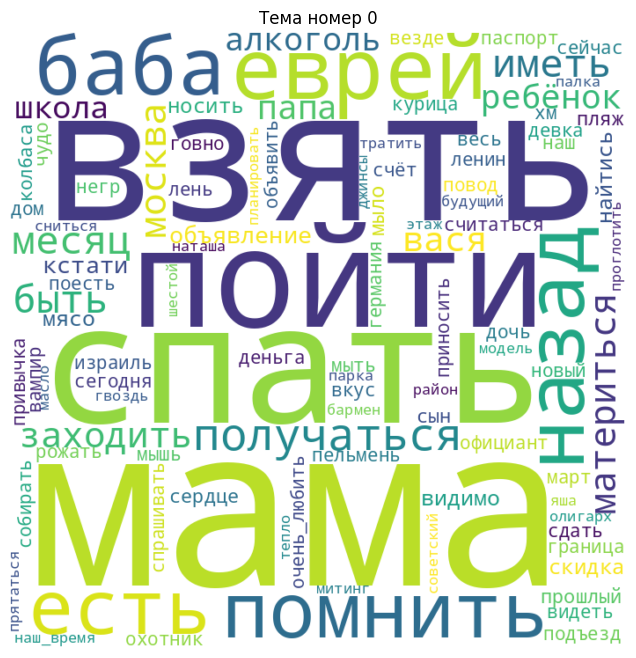

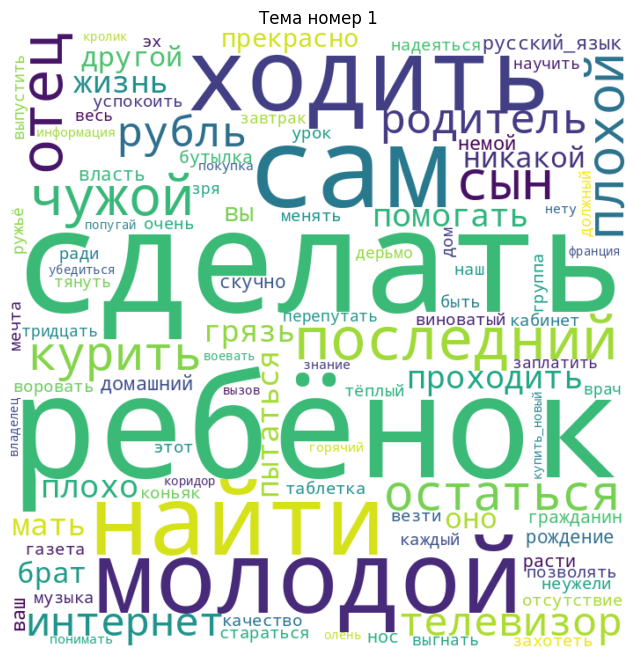

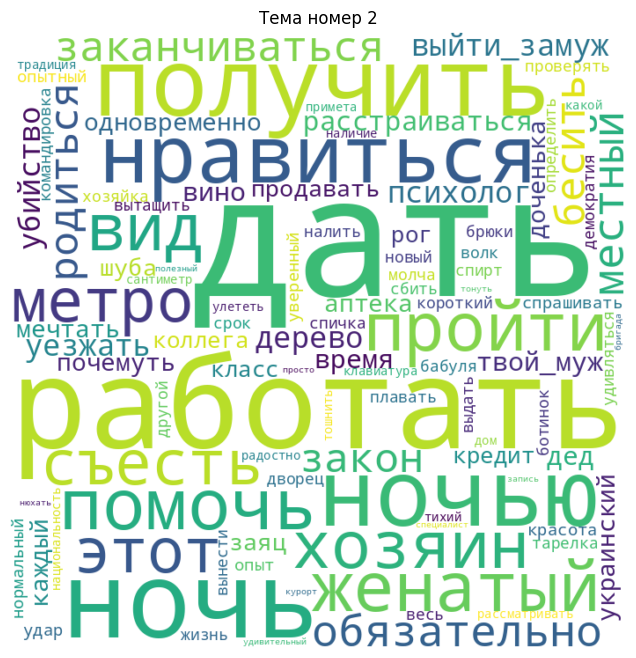

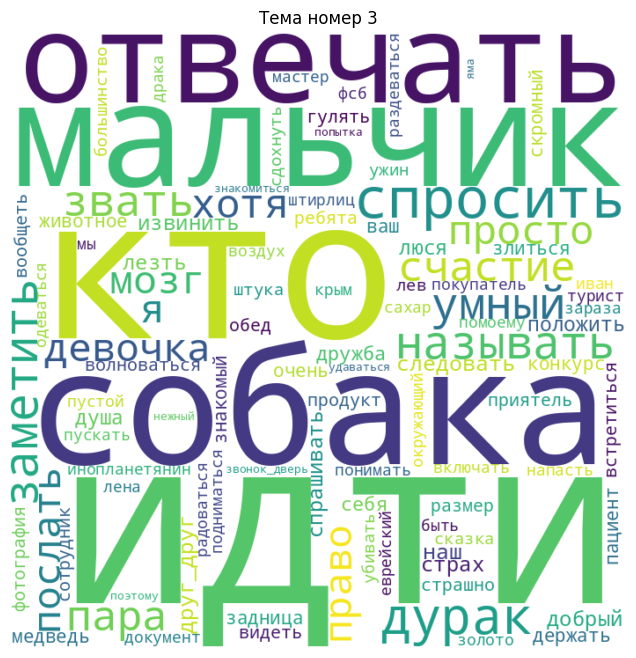

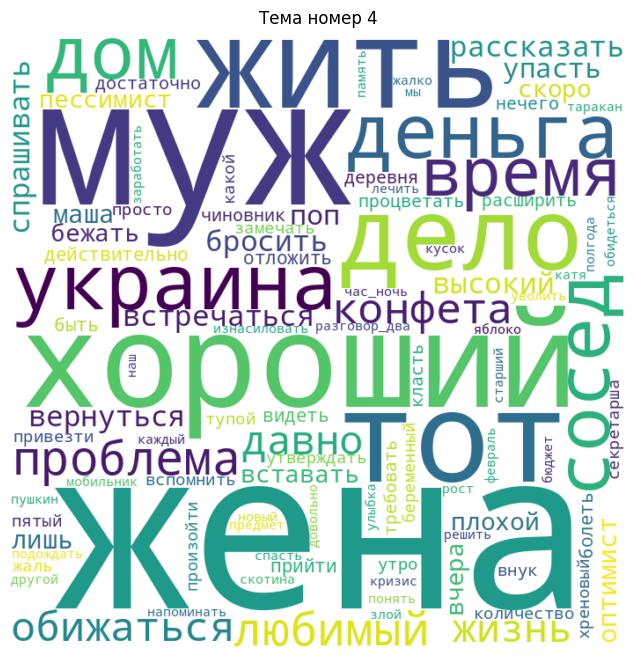

...

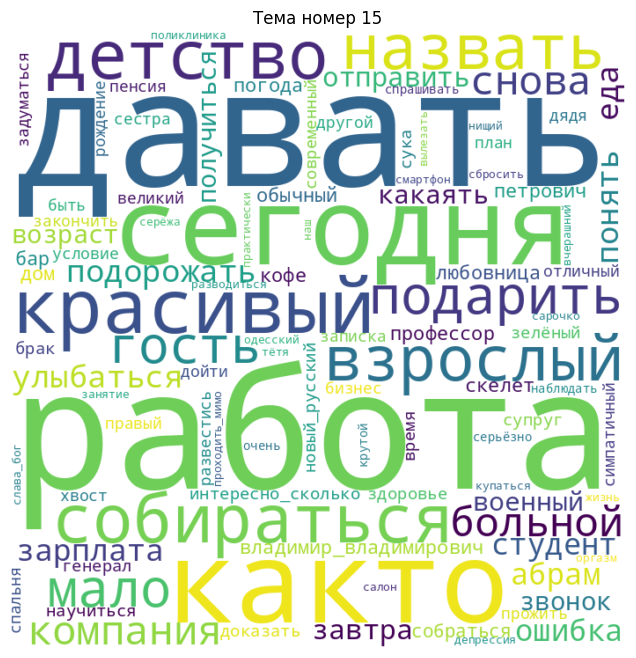

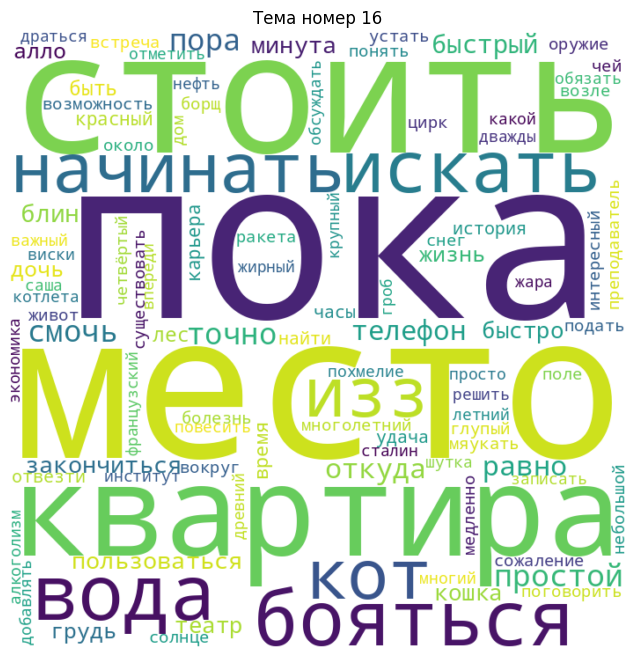

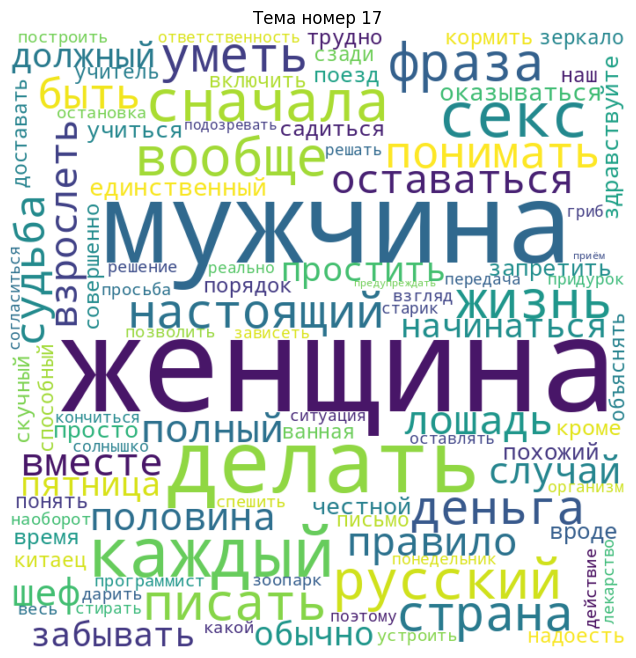

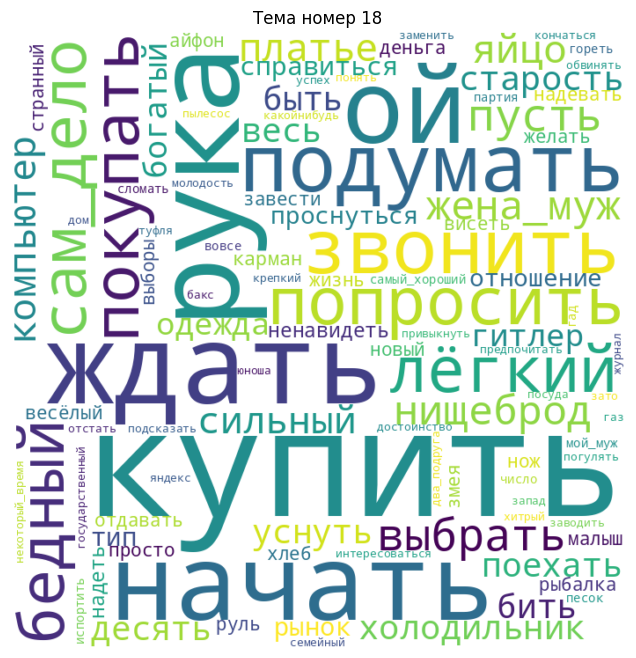

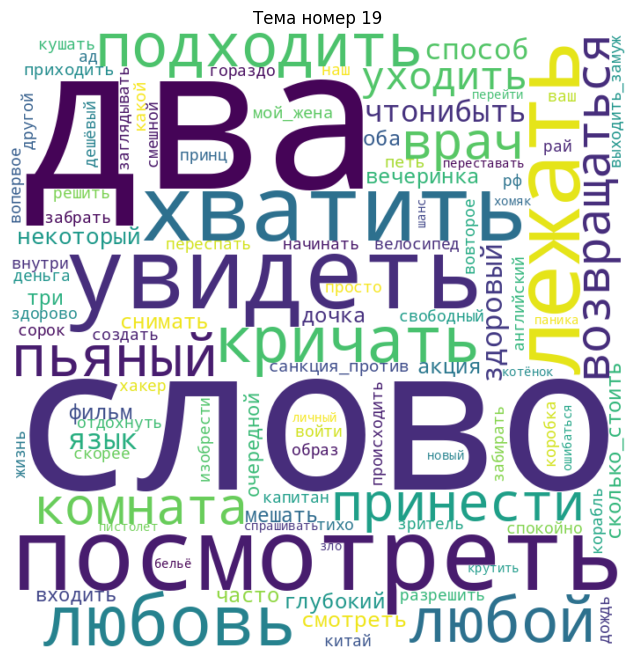

In [ ]:
generate_clouds(20, topics_20_bigrams_common)

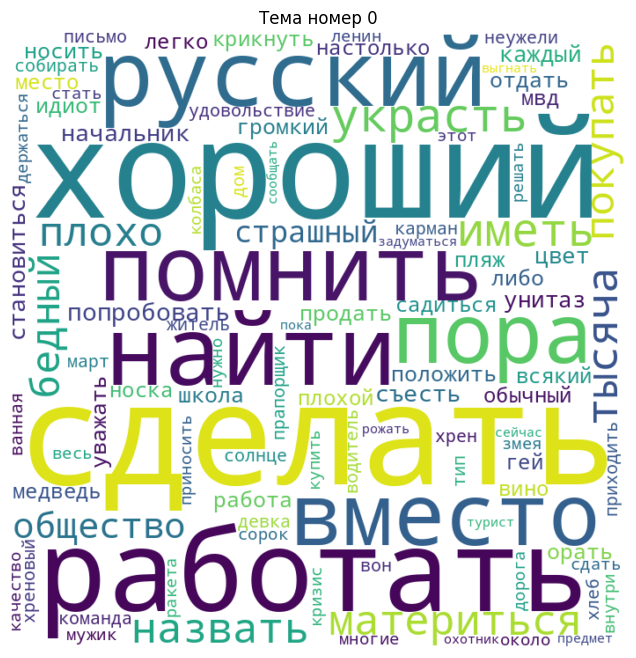

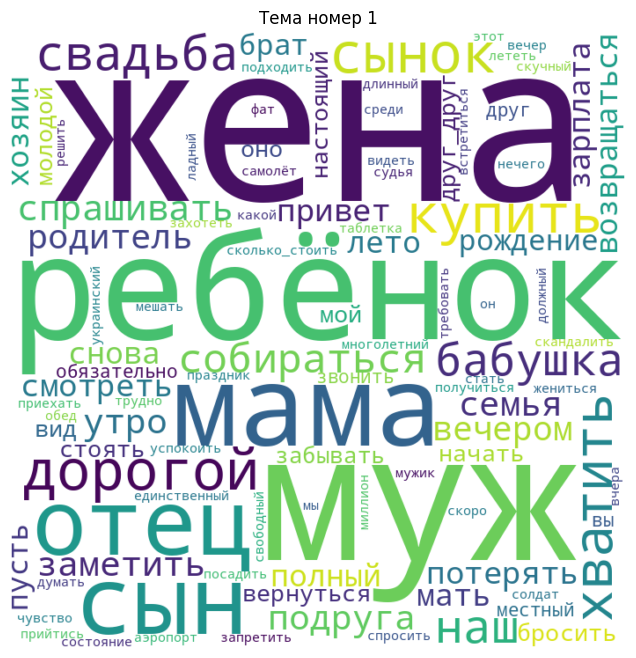

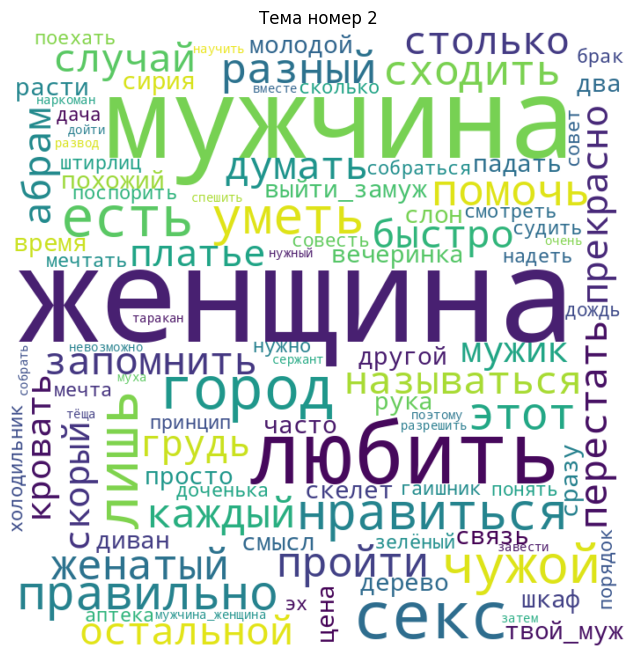

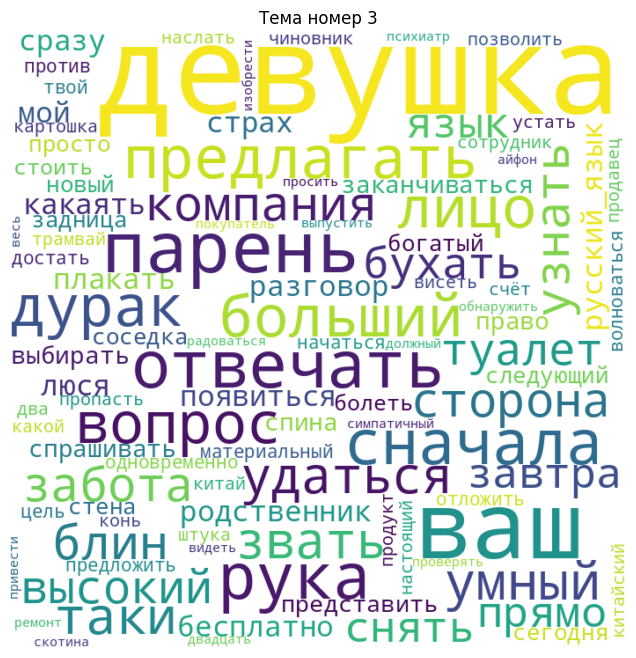

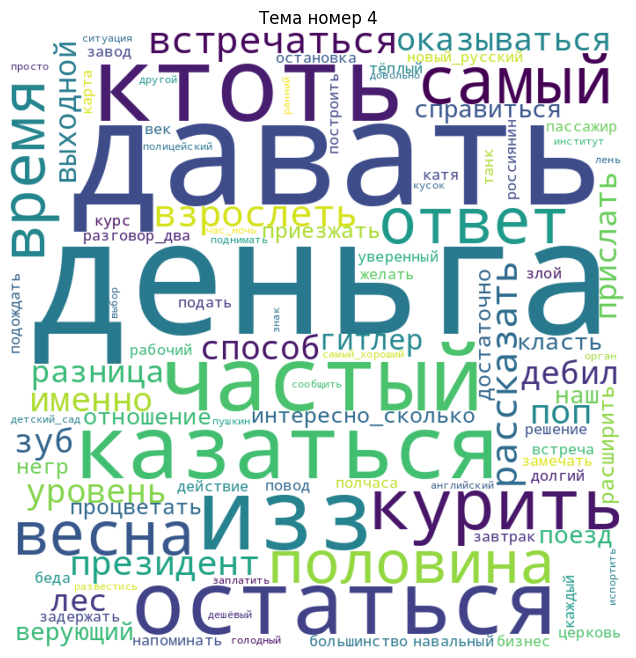

...

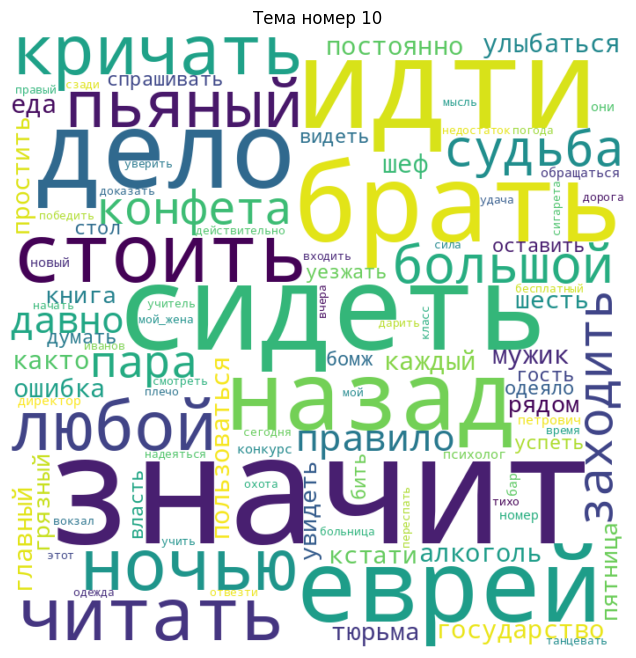

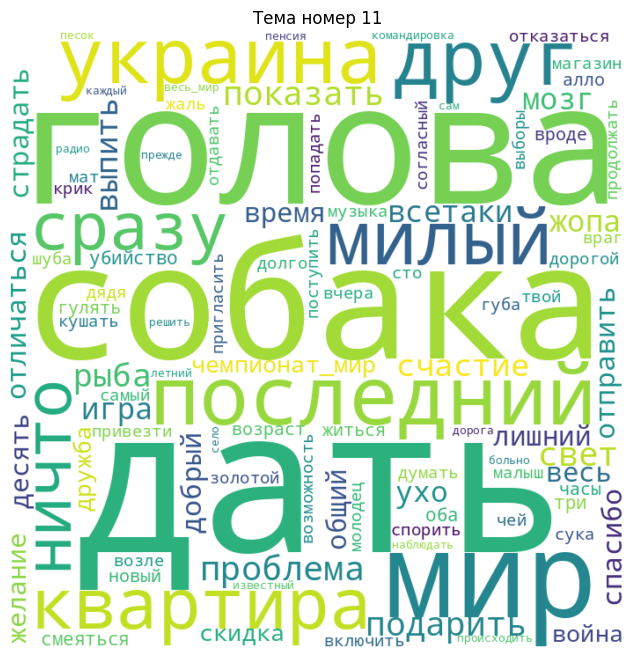

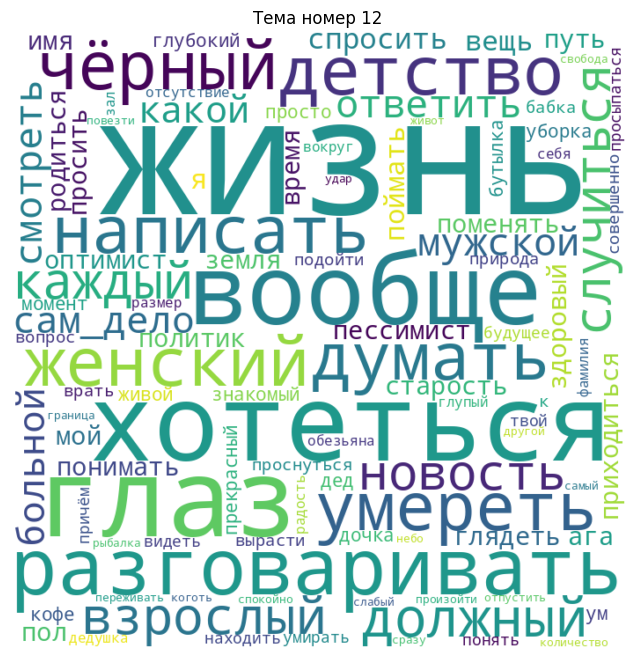

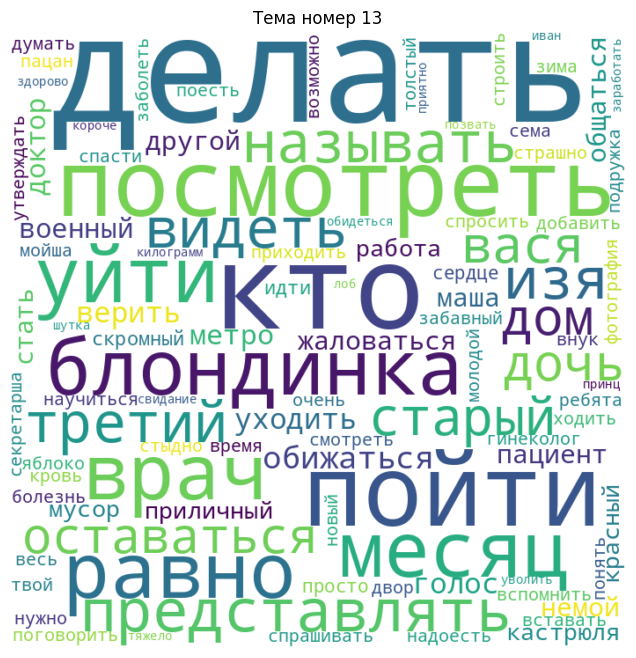

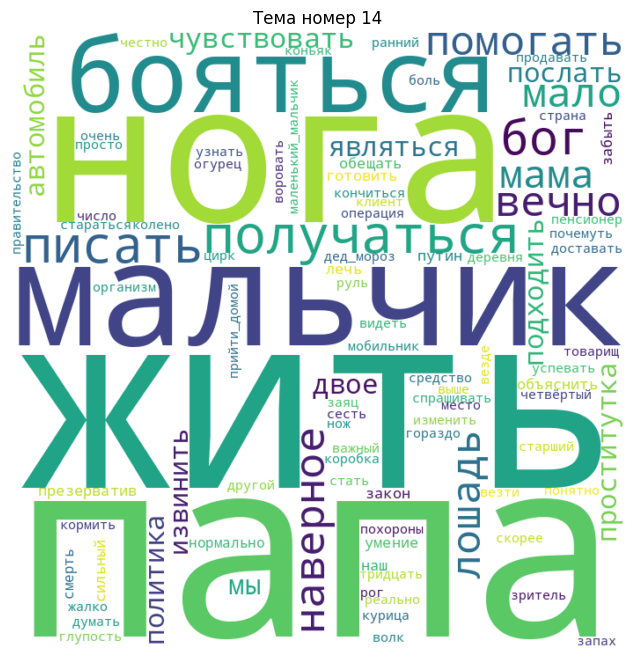

In [ ]:
generate_clouds(15, topics_15_bigrams_common)

In [ ]:
from sklearn.metrics import silhouette_score
def get_predicted_classes(lda_model, corpus):
    predicted_classes = []
    for bow in corpus:
        topic_distribution = lda_model.get_document_topics(bow)
        predicted_class = max(topic_distribution, key=lambda x: x[1])[0]
        predicted_classes.append(predicted_class)
    return predicted_classes
predicted_classes = get_predicted_classes(lda_15_bigrams_common, corpus)

In [ ]:
def get_topic_distributions(lda_model, corpus):
    topic_distributions = []
    for bow in corpus:
        topic_distribution = lda_model.get_document_topics(bow, minimum_probability=0)
        topic_distribution = [prob for _, prob in topic_distribution]
        topic_distributions.append(topic_distribution)
    return np.array(topic_distributions)

topic_distributions = get_topic_distributions(lda_15_bigrams_common, corpus)

predicted_classes = np.argmax(topic_distributions, axis=1)

score = silhouette_score(topic_distributions, predicted_classes)
print(f'Silhouette Score: {score}')

Silhouette Score: 0.14035564661026


In [67]:
topic_distributions = get_topic_distributions(lda_20_bigrams_common, corpus)

predicted_classes = np.argmax(topic_distributions, axis=1)

score = silhouette_score(topic_distributions, predicted_classes)
print(f'Silhouette Score: {score}')

Silhouette Score: 0.11261492222547531


In [ ]:
type(predicted_classes)

list

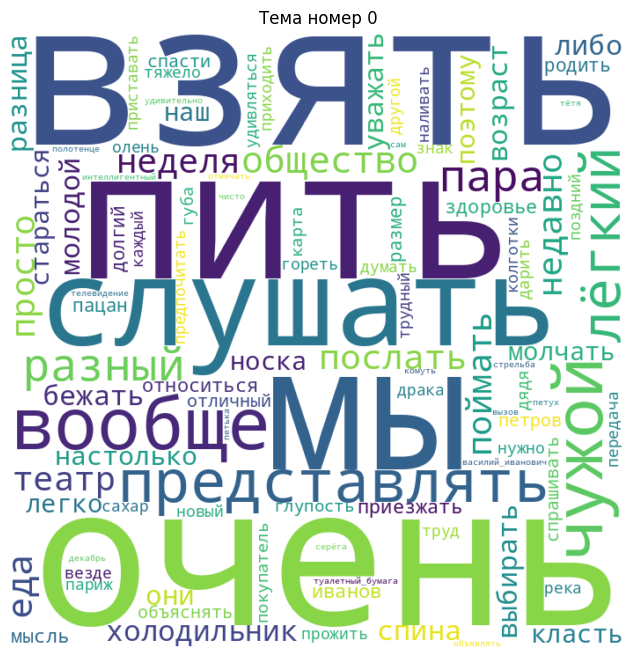

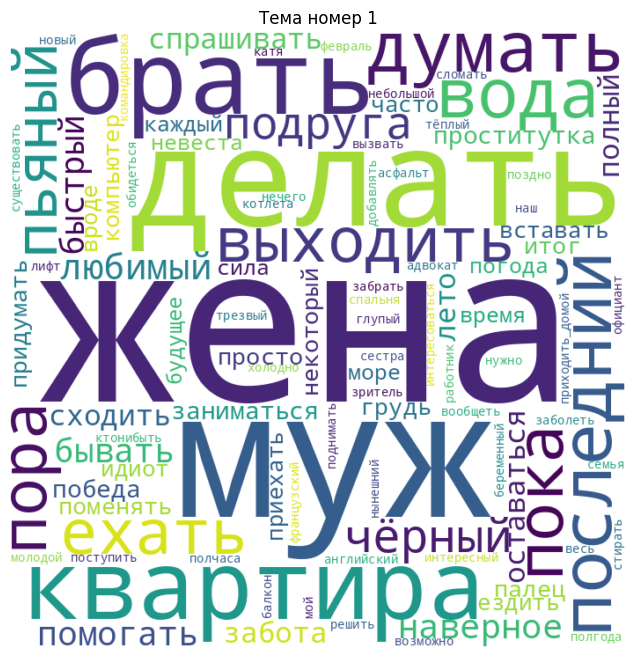

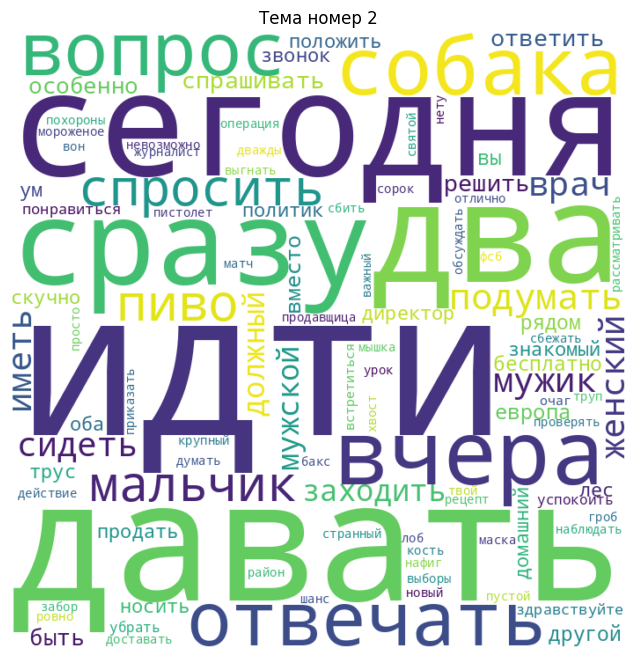

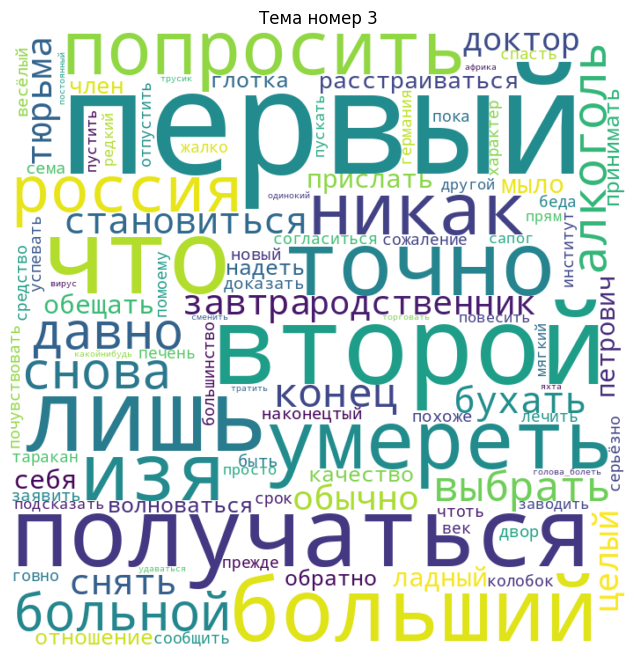

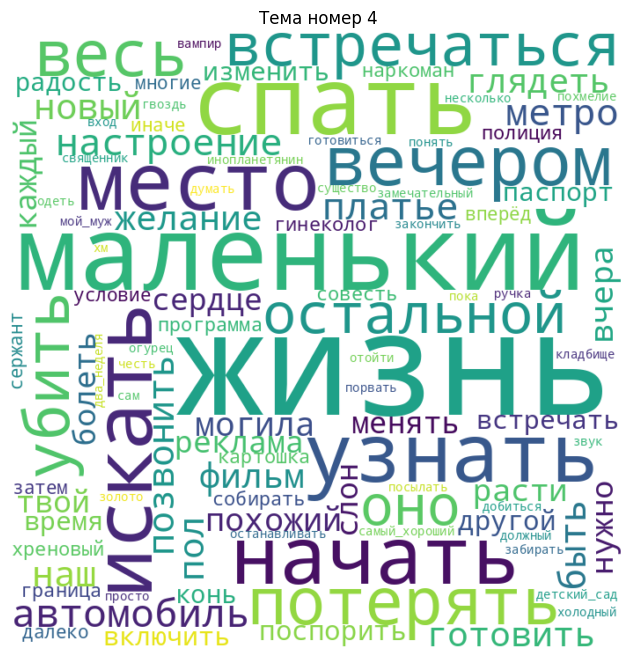

...

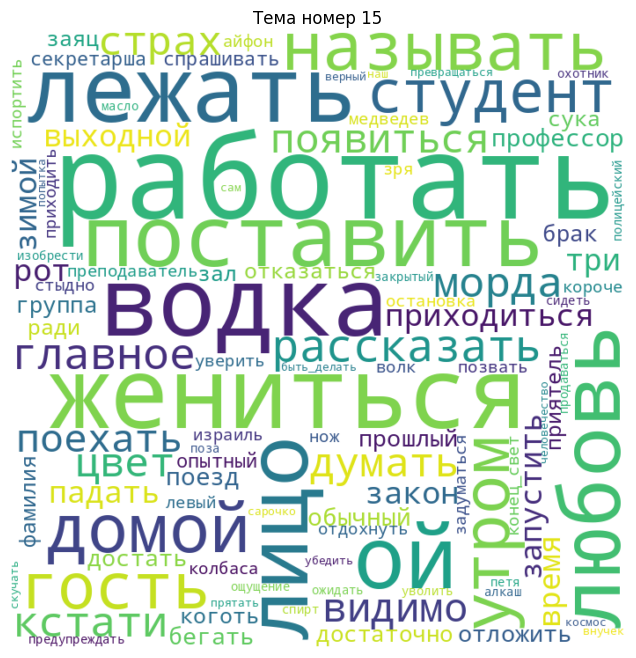

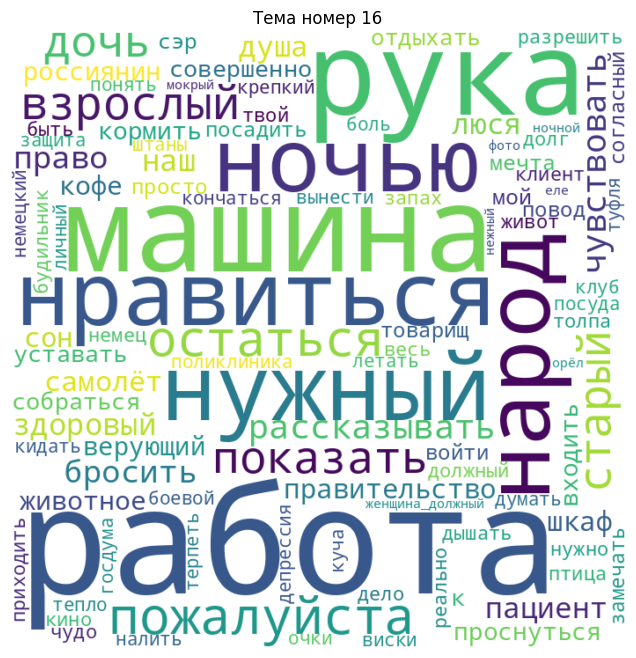

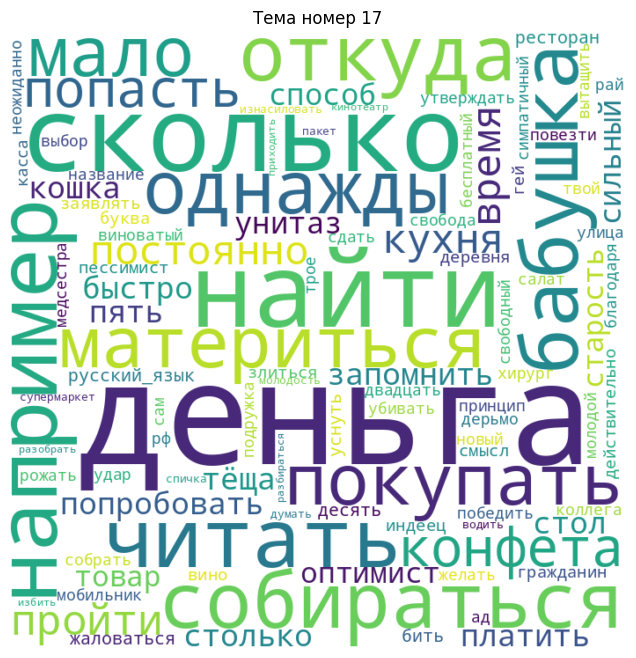

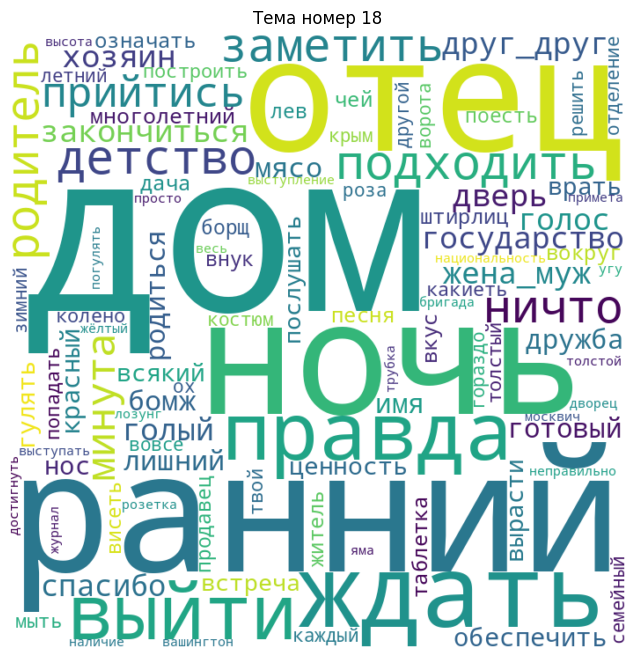

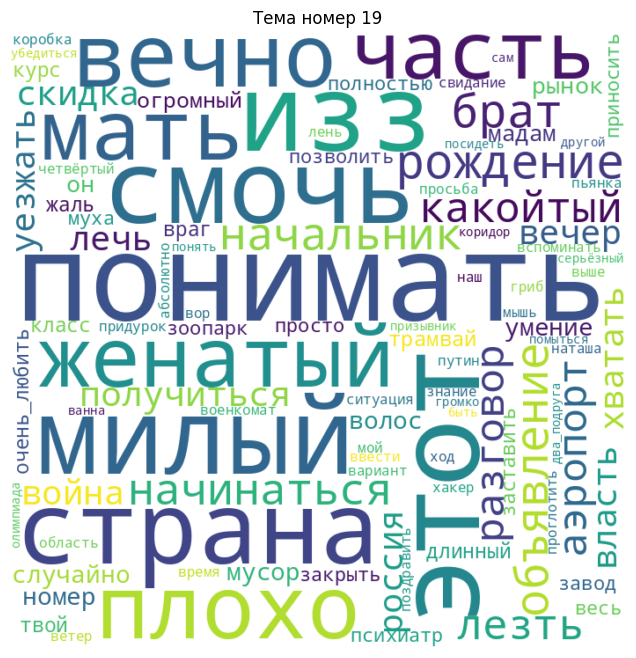

In [ ]:
generate_clouds(20, topics_20_bigrams_common)

TO-DO: еще поподбирать параметры имперически,
поперебирать параметры сравниваясь по метрике Coherence Score и Perplexity.
Офрмить ноутбук получше(импорты все в начало, оформить обучение и создание корпуса в функции)

Сравнение моделей через тепловую матрицу

In [ ]:
documents_bi = data["result_without_common"].values
tokenized_documents_bi = [doc.split() for doc in documents_bi]

bigram = models.Phrases(tokenized_documents_bi, min_count = 3, threshold = 4)

bigram_mod = models.phrases.Phraser(bigram)

def make_bigrams(texts):
  return [bigram_mod[doc] for doc in texts]

result_texts_bi = make_bigrams(tokenized_documents_bi)

dictionary_bi = gensim.corpora.Dictionary(result_texts_bi)
print('Размер словаря до фильтрации: {}'.format(len(dictionary_bi)))
print(dictionary_bi)
dictionary_bi.filter_extremes(no_below=8, no_above=0.2)
dictionary_bi.compactify()
print('Размер словаря после фильтрации: {}'.format(len(dictionary_bi)))
print(dictionary_bi)

dictionary_witout_bigrams = gensim.corpora.Dictionary(tokenized_documents_bi)
dictionary_witout_bigrams.filter_extremes(no_below=8, no_above=0.2)
dictionary_witout_bigrams.compactify()
print('Размер словаря без биграм после фильтрации: {}'.format(len(dictionary_witout_bigrams)))
print(dictionary_witout_bigrams)

Размер словаря до фильтрации: 79245
Dictionary<79245 unique tokens: ['готовый', 'друг', 'мой', 'немного', 'плохой']...>
Размер словаря после фильтрации: 17132
Dictionary<17132 unique tokens: ['готовый', 'друг', 'мой', 'немного', 'плохой']...>
Размер словаря без биграм после фильтрации: 13424
Dictionary<13424 unique tokens: ['готовый', 'друг', 'мой', 'немного', 'плохой']...>


In [ ]:
score_bi = get_Coherence_Score_u_mass(lda_model_bi, documents_bi, corpus_bi)
perplexity_score_bi = get_Perplexity_Score(lda_model_bi, corpus_bi)
print(score_bi, perplexity_score_bi)

-7.574965705664803 -12.454359097750668


In [ ]:
show_results(lda_model_bi, corpus_bi, dictionary_bi)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
7     -0.131369 -0.096151       1        1  8.221376
14    -0.133033 -0.100246       2        1  7.852480
12    -0.019799 -0.145415       3        1  7.279115
3     -0.201384  0.045823       4        1  7.142583
11    -0.113030  0.115096       5        1  7.113535
5      0.140005 -0.156764       6        1  6.731635
9     -0.106442 -0.058009       7        1  6.636352
13    -0.141924 -0.006484       8        1  6.574102
2     -0.003845 -0.005382       9        1  6.563830
1      0.115113  0.023473      10        1  6.368215
0      0.127305 -0.128183      11        1  6.214219
8      0.138293  0.039728      12        1  6.141413
6      0.027020  0.182530      13        1  5.973868
10     0.251457 -0.017813      14        1  5.723695
4      0.051634  0.307795      15        1  5.463582, topic_info=                Term         Freq        Total Category  logprob  loglift
13              жена  7688.000000  7688.000000  Default  30.0000  30.0000
33              итог  7070.000000  7070.000000  Default  29.0000  29.0000
60    молодой_парень  4927.000000  4927.000000  Default  28.0000  28.0000
289           причём  4628.000000  4628.000000  Default  27.0000  27.0000
37            понять  4437.000000  4437.000000  Default  26.0000  26.0000
...              ...          ...          ...      ...      ...      ...
174            визит   688.876416  1201.528142  Topic15  -4.2165   2.3508
432        серьёзный   625.729967  1247.615476  Topic15  -4.3126   2.2170
1226        компания   436.077147   670.680934  Topic15  -4.6737   2.4766
1270          флешка   503.315062  1577.565964  Topic15  -4.5303   1.7646
576        приходить   446.562866   903.618683  Topic15  -4.6500   2.2022

[581 rows x 6 columns], token_table=      Topic      Freq             Term
term                                  
1059      8  0.997386          автобус
2843     10  0.999024              акт
213       5  0.998424          актриса
2848     12  0.997475          алексей
1539      7  0.997104            алмаз
...     ...       ...              ...
105       9  0.999376             этот
775       3  0.999124    эффективность
635      13  0.997529        ювелирный
2945     10  0.995772             юный
1526     13  0.998729  я_разговаривать

[764 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[8, 15, 13, 4, 12, 6, 10, 14, 3, 2, 1, 9, 7, 11, 5])

Теперь переберем оптимальное количество топиков, основываясь на приведенных выше метриках. По метрикам получилось лучше с добавлением биграм


In [ ]:
def compute_metrics_values(dictionary, corpus, documnets, limit, start, step):
    """
    dictionary : Gensim dictionary
    corpus : Gensim corpus
    documents : List of input texts
    limit : Max num of topics
    """
    coherence_and_perplexity_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        #model = gensim.models.wrappers.LdaMallet(mallet_path, corpus=corpus, num_topics=num_topics, id2word=id2word)
        lda_model = models.ldamodel.LdaModel(corpus = corpus, id2word = dictionary, num_topics = num_topics, passes = 7, random_state = 42)
        model_list.append(lda_model)
        coherence_model = get_Coherence_Score_u_mass(lda_model, documnets, corpus)
        perplexity_model = get_Perplexity_Score(lda_model, corpus)
        coherence_and_perplexity_values.append((coherence_model, perplexity_model))
    return model_list, coherence_and_perplexity_values


In [ ]:
def show_metrics_graph(coherence_and_perplexity_values, limit, start, step):
  x = range(start, limit, step)
  coherence_values = [pair[0] for pair in coherence_and_perplexity_values]
  perplexity_values = [pair[1] for pair in coherence_and_perplexity_values]
  # plt.plot(x, coherence_values)
  # plt.xlabel("Num Topics")
  # plt.ylabel("Coherence score")
  # plt.legend(("coherence_values"), loc='best')
  # plt.show()
  fig, ax1 = plt.subplots()

  ax1.plot(x, coherence_values, 'b-')
  ax1.set_xlabel("Num Topics")
  ax1.set_ylabel("Coherence score", color='b')
  ax1.tick_params(axis='y', labelcolor='b')
  ax1.legend(["coherence_values"], loc='best')

  ax2 = ax1.twinx()
  ax2.plot(x, perplexity_values, 'r-')
  ax2.set_ylabel("Perplexity score", color='r')
  ax2.tick_params(axis='y', labelcolor='r')
  ax2.legend(["perplexity_values"], loc='best')

  plt.show()

In [ ]:
def show_metrics_values(coherence_and_perplexity_values, limit, start, step):
  x = range(start, limit, step)
  for m, coh, per in zip(x, coherence_and_perplexity_values):
      print("Num Topics =", m, " Coherence value:", round(coh, 4), "Perplexity value: ", round(per, 4))